# Stable Diffusion Inference
This is a notebook for using Stable Diffusion Hugging Face Pipelines. HF Pipelines offer an easy way to utilize various Stable Diffusion models for inference with little code.

This notebook consists of the following functionalities:
- Text to image generation (768x768)
- Upscale images (512x512 -> 2048x2048) (upscaling higher resolution images requires more GPU VRAM)
- Stepped image generation (visualize various steps of the diffusion process)
- Image to image generation (768x768)
- Image resizing utility (no diffusion) - does not effect resolution of the image

Some of this code was adapted from [Practical Deep Learning For Coders](https://course.fast.ai/) (Jeremy Howard @ fast.ai).

### Setup
Run the following line from the command line to create the appropriate environment to work with this notebook:

`conda env create -f environment.yml`

This will setup a conda environment and install all of the necessary pip dependencies.

Activate the end and then run the following line to set up a Jupyter kernel:

`python -m ipykernel install --user --name stable-diffusion --display-name "stable-diffusion (Python 3.9)"`

#### Hugging Face Login
Accept models licenses with Hugging Face

In [1]:
from pathlib import Path
from huggingface_hub import notebook_login
if not (Path.home()/'.huggingface'/'token').exists(): notebook_login()

### Imports & Functions

In [2]:
from PIL import Image
import matplotlib.pyplot as plt
import torch

# Stable Diffusion Pipelines
from diffusers import StableDiffusionPipeline, EulerDiscreteScheduler,\
                       DPMSolverMultistepScheduler, StableDiffusionUpscalePipeline,\
                       StableDiffusionImg2ImgPipeline

In [3]:
def image_grid(imgs, rows, cols):
    w,h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    for i, img in enumerate(imgs): grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

## Text To Image Generation
Generate an image from text.

In [4]:
# Image prompt
prompt = "a person staring across vast mountains covered in pine trees with lakes beneath"
negative_prompt = "" #"roads" # optional negative prompt
save_image_name = "mountains4" # Filename of image to be saved
manual_seed = 1024 # Set manual seed (for repeatability). False for random output.

In [5]:
# Model ID
model_id = "stabilityai/stable-diffusion-2-1" # Stable Diffusion 2.1

#### Schedulers
- 2 scheduler options:
    - DPM
    - Euler

In [6]:
# DPMSolverMultistepScheduler (DPM-Solver++) scheduler
pipe = StableDiffusionPipeline.from_pretrained(model_id, torch_dtype=torch.float16)
pipe.scheduler = DPMSolverMultistepScheduler.from_config(pipe.scheduler.config)

# # Euler scheduler
# scheduler = EulerDiscreteScheduler.from_pretrained(model_id, subfolder="scheduler")
# pipe = StableDiffusionPipeline.from_pretrained(model_id, scheduler=scheduler, torch_dtype=torch.float16)

# Assign to GPU
pipe = pipe.to("cuda")

  0%|          | 0/50 [00:00<?, ?it/s]

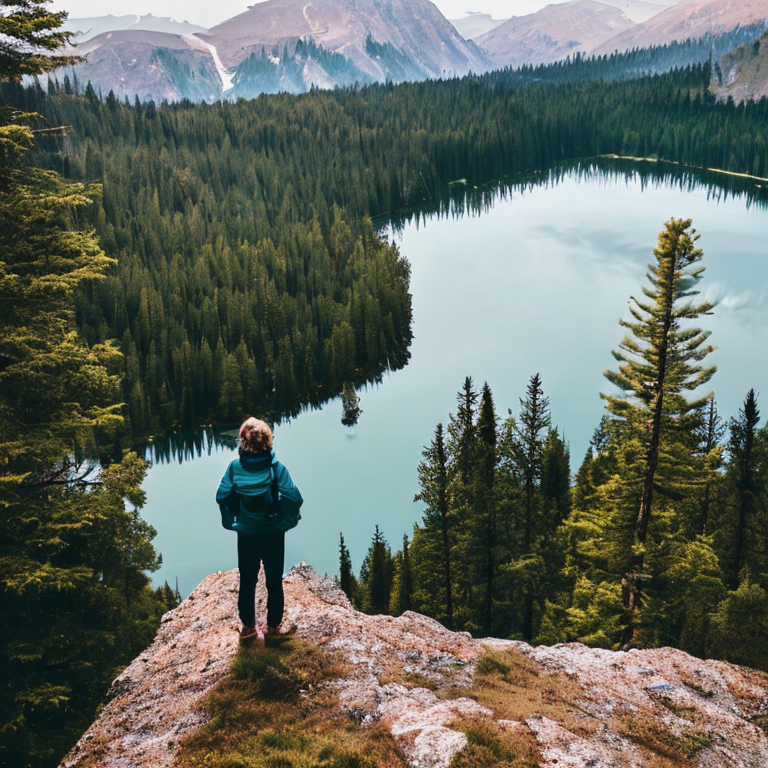

In [7]:
# Set seed
if manual_seed:
    torch.manual_seed(manual_seed)
    
# Generate image
image = pipe(prompt, negative_prompt=negative_prompt).images[0]
# latents = pipe(prompt, output_type="latent").images
image.save(f"{save_image_name}_768x768.png") # save 768x768 image
image.show() # display image
torch.cuda.empty_cache() # empty CUDA cache after model run to free GPU memory

## 4x Upscaler
Upscale images by 4x. The upscaler requires a significant amount of CUDA memory, therefore only 512x512 (or lower) images can be upscaled to 2048x2048. Higher resolution images can be upscaled, but it will require >16GB VRAM.

In [8]:
# Specify the file path of the image
image_path = 'mountains4_768x768.png'

# Image prompt (optional) - Add additional image prompt
# prompt = "Add additional prompt here"

# define image to be resized to (only if larger than this dim)
# image_dim cannot exceed 512 to run on <16GB VRAM
image_dim = 512

In [9]:
# Open the image
image = Image.open(image_path)

# Resize image if too large
if image.size[0] > image_dim or image.size[0] > image_dim:
    image = image.resize((image_dim, image_dim))

# Display basic information about the image
print("Image format:", image.format)
print("Image size:", image.size)
print("Image mode:", image.mode)

Image format: None
Image size: (512, 512)
Image mode: RGB


  0%|          | 0/75 [00:00<?, ?it/s]

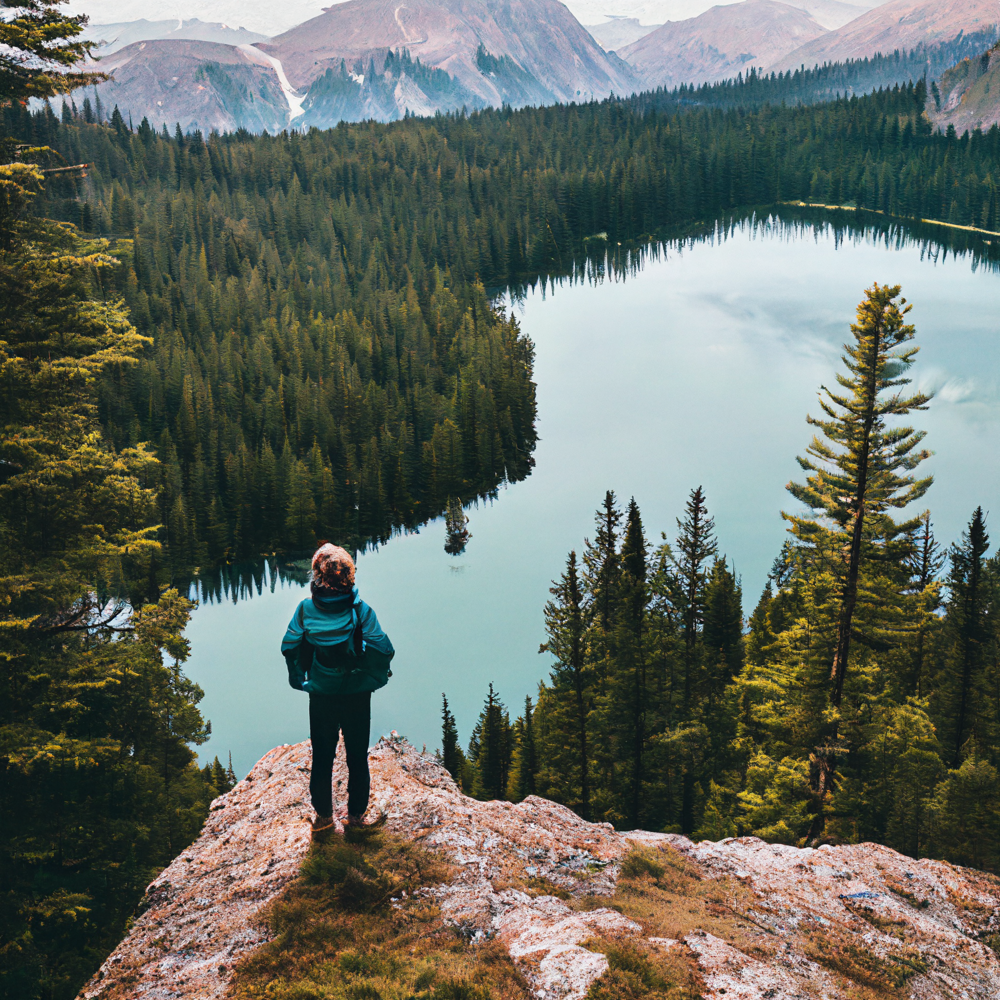

In [10]:
# Upscale image
# load model and scheduler
model_id = "stabilityai/stable-diffusion-x4-upscaler"
pipe = StableDiffusionUpscalePipeline.from_pretrained(model_id, torch_dtype=torch.float16).to("cuda")
pipe.enable_attention_slicing() # improves memory usage

# set seed
if manual_seed:
    torch.manual_seed(manual_seed)

# Adjust for memory and upsample
pipe.set_use_memory_efficient_attention_xformers(True) # required to fit on 16GB VRAM
upscaled_image = pipe(prompt=prompt, image=image).images[0]
upscaled_image.save(f"{save_image_name}_2048x2048.png")
upscaled_image.show()
torch.cuda.empty_cache() # empty CUDA cache after model run to free GPU memory

## Image to Image
Provide and input image to generate something similar.

In [11]:
# Image prompt
prompt = "a robot"

# Specify the file path of the input image
in_image_path = 'mountains4_768x768.png'

/root/miniconda3/envs/stable-diffusion/lib/python3.9/site-packages/diffusers/pipelines/stable_diffusion/pipeline_stable_diffusion_img2img.py:591: FutureWarning: You have passed 3 text prompts (`prompt`), but only 1 initial images (`image`). Initial images are now duplicating to match the number of text prompts. Note that this behavior is deprecated and will be removed in a version 1.0.0. Please make sure to update your script to pass as many initial images as text prompts to suppress this warning.
  deprecate("len(prompt) != len(image)", "1.0.0", deprecation_message, standard_warn=False)


  0%|          | 0/40 [00:00<?, ?it/s]

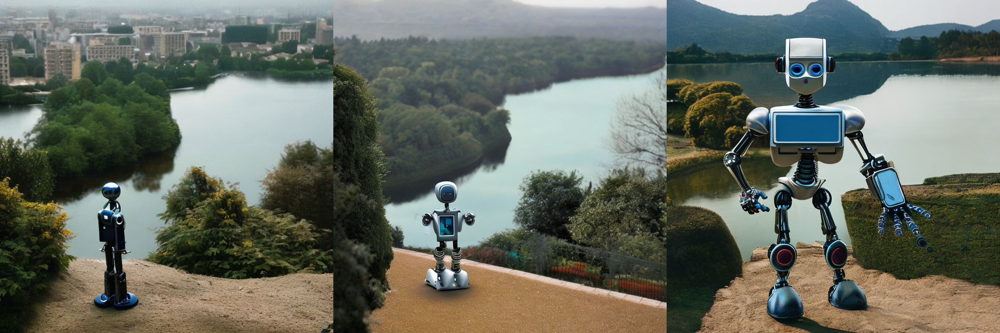

In [12]:
# Reassign pipeline object
pipe = StableDiffusionImg2ImgPipeline.from_pretrained("stabilityai/stable-diffusion-2-1", torch_dtype=torch.float16).to("cuda")

# Open the input image
init_image = Image.open(in_image_path).convert("RGB") # convert to RGB if not already
# init_image.show()

if manual_seed:
    torch.manual_seed(manual_seed)
images = pipe(prompt=prompt, num_images_per_prompt=3, image=init_image, strength=0.8, num_inference_steps=50).images
image_grid(images, rows=1, cols=3).show()
torch.cuda.empty_cache() # empty CUDA cache after model run to free GPU memory

## Stepped Images
Generate steps in the diffusion process

In [17]:
prompt = "intricate and detailed photograph of an astronaut playing a neon electric guitar in space with galaxies, electricity, planets, stars, comets, shooting stars, high resolution photorealistic 4k" #colorful high resolution 4k photograph
# prompt = "a golden doodle puppy sitting on a dog bed with a tennis ball"
# prompt = "colorful high resolution 4k photograph of a portal with a neon electric guitar in space with galaxies, electricity, planets, stars, comets, shooting stars"
# prompt = "portal to galaxies, stars, planets, suns, comets"

  0%|          | 0/50 [00:00<?, ?it/s]

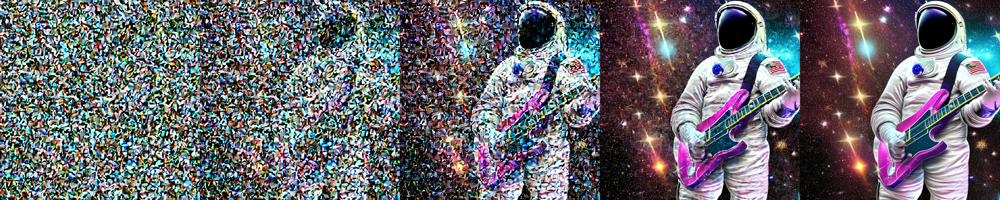

In [14]:
# Reassign pipeline object
pipe = StableDiffusionPipeline.from_pretrained("stabilityai/stable-diffusion-2-1", torch_dtype=torch.float16).to("cuda")

# code modified frmo fast.ai
vae = pipe.vae # instntiate vae object
images = [] # initialize images

def latents_callback(i, t, latents):
    latents = 1 / 0.18215 * latents
    image = vae.decode(latents).sample[0]
    image = (image / 2 + 0.5).clamp(0, 1)
    image = image.cpu().permute(1, 2, 0).numpy()
    images.extend(pipe.numpy_to_pil(image))

if manual_seed:
    torch.manual_seed(manual_seed)
final_image = pipe(prompt, callback=latents_callback, callback_steps=15).images[0]
images.append(final_image)
image_grid(images, rows=1, cols=len(images)).show()
torch.cuda.empty_cache() # empty CUDA cache after model run to free GPU memory

## Resize Image Utility
Simple Python utility to resize image to any resolution.
This does not involve diffusion, therefore upsampling here does not improve quality.

In [15]:
# Specify the file path of the input image
in_image_path = 'mountains4_2048x2048.png'
image_dim = 3072 # square image
save_image_path = 'mountains4_3072x3072.png'

In [16]:
# Open the input image using Pillow
in_image = Image.open(in_image_path)

# Upsample the image to the desired size (image_dim x image_dim)
save_image = in_image.resize((image_dim, image_dim))

# Save the upsampled image to a new file
save_image.save(save_image_path)

# Close the image files
in_image.close()
save_image.close()